# Generative Models Assignment  
**Points:** 125 + 40 Bonus  

---

## Diffusion Models vs. GANs  
**Homework 4**  
**Deep Learning Course**  
**Instructor:** Dr. Beigy  
**Fall 2024**  

---

### **Student Information**  
- **Full Name:** Zahra Fallah MirMousavi  
- **Student ID (SID):** 401207192
---



In this notebook, we are going to implement Denoising Diffusion Probabilistic Model (DDPM) and Generative Adversarial Network (GAN) on the FashionMNIST dataset. To generate images, these models convert noise to images from the training distribution, but the key difference is that Diffusion models denoise the image gradually. The following sections briefly describe each model.

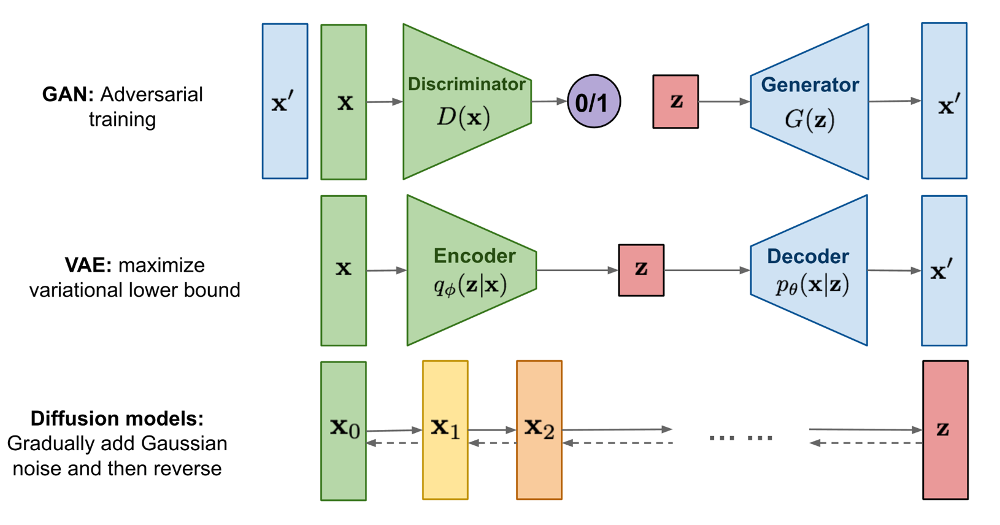

---

## **NOTICE**

- **Complete the Code:**  
  Ensure your implementation follows the provided structure. While you may adjust hyperparameters to fit your computing resources, your results must demonstrate the desired performance.

- **Address the `TODO` Sections:**  
  Fill in the `TODO` parts of the code with appropriate logic and functionality.

- **Answer Conceptual Questions:**  
  Provide thorough and accurate responses to all conceptual questions included in the task.

---

## Dataset Overview

In this notebook, we will work with the **FashionMNIST** dataset. This dataset includes:

- **Training Set**: 60,000 examples
- **Test Set**: 10,000 examples

Each sample is a **28x28 grayscale image** associated with one of **10 classes**. For the purpose of this notebook, we will focus on the training split.

### Utilities Available:
- **`dataloader`**: Use this to load and iterate through the dataset for model training.
- **`plot_images`**: A utility to visualize sequences of images, such as iteratively denoised images generated by a DDPM (Denoising Diffusion Probabilistic Model).

This setup allows for efficient training and evaluation of your models while providing tools for insightful visualization of results.


In [ ]:
from torchvision import transforms
from torch.utils.data import DataLoader
from torch import optim
from tqdm.notebook import tqdm
from torch.autograd import Variable
from torch.optim.lr_scheduler import ReduceLROnPlateau
import math

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import matplotlib.pyplot as plt

# Constants
BATCH_SIZE = 8
IMG_SIZE = 32
C_IN = 1  # Number of input channels
LR = 2e-5
EPOCHS = 500

# Device configuration
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
Tensor = torch.cuda.FloatTensor if DEVICE == 'cuda' else torch.FloatTensor

100%|██████████| 26.4M/26.4M [00:02<00:00, 11.6MB/s]


Extracting ./FashionMNIST/raw/train-images-idx3-ubyte.gz to ./FashionMNIST/raw



100%|██████████| 29.5k/29.5k [00:00<00:00, 170kB/s]


Extracting ./FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./FashionMNIST/raw



100%|██████████| 4.42M/4.42M [00:01<00:00, 3.26MB/s]


Extracting ./FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./FashionMNIST/raw



100%|██████████| 5.15k/5.15k [00:00<00:00, 8.91MB/s]


Extracting ./FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./FashionMNIST/raw



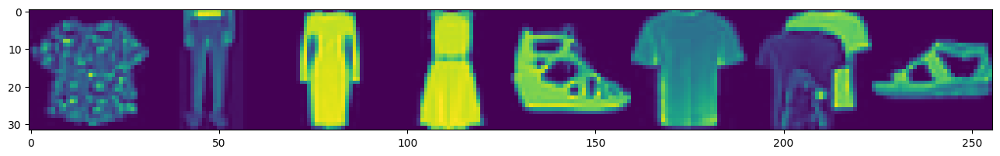

In [ ]:
def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Lambda(lambda t: (t * 2) - 1)
    ]

    data_transform = transforms.Compose(data_transforms)
    data = torchvision.datasets.FashionMNIST(root=".", download=True, train=True, transform=data_transform)
    return data


def plot_images(images):
    plt.figure(figsize=(16, 3))
    plt.imshow(torch.cat([torch.cat([i for i in images], dim=-1)], dim=-2).permute(1, 2, 0).cpu())
    plt.show()


data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)
batch_x, batch_y = next(iter(dataloader))
plot_images(batch_x[:8])

## GAN (40 + 15 points)

GAN's architecture consists of a Discriminator and a Generator. The Discriminator identifies whether an input image ($x$) is real or generated by the Generator. The Generator tries to create fake images given a random noise ($z$) such that the Discriminator can not distinguish them from the real images. These functionalities give rise to an adversarial situation where these networks can be seen as players. Thus, the standard loss for GAN is the following min-max loss. The Generator tries to minimize it, while the Discriminator tries to maximize it.

$$ \min_{\theta_g} \max_{\theta_d} E_{x \sim p_{data}}[log(D_{\theta_d}(x)] + E_{z \sim p(z)}[log(1 - D_{\theta_d}(G_{\theta_g}(z)))] $$

We try to optimize this loss function by alternating between the following objectives for the Discriminator and the Generator:
+ Discriminator's objective:
 $$ \max_{\theta_d} E_{x \sim p_{data}}[log(D_{\theta_d}(x)] + E_{z \sim p(z)}[log(1 - D_{\theta_d}(G_{\theta_g}(z)))] $$
+ Generator's objective:
$$ \min_{\theta_g} E_{z \sim p(z)}[log(1 - D_{\theta_d}(G_{\theta_g}(z)))] $$

Each player’s cost depends on the parameters of the other player. However, each
player can only optimize its own parameters.

### ❓ **Question 1**

#### *(8 points)*  
> **What are the challenges in this optimization process?**  
> **How are these challenges addressed?**


<table>
  <tr>
    <th>Issue</th>
    <th>Description</th>
    <th>Possible Solutions</th>
  </tr>
  <tr>
    <td>Mode Collapse</td>
    <td>The generator produces a limited set of output samples that do not cover the full distribution of the input data.</td>
    <td>
      <ul>
        <li>Minibatch discrimination</li>
        <li>Adding noise to the input or output</li>
        <li>Using loss functions like Wasserstein GAN or hinge loss</li>
      </ul>
    </td>
  </tr>
  <tr>
    <td>Vanishing Gradients</td>
    <td>Gradients passed from the discriminator to the generator become very small, slowing or halting training.</td>
    <td>
      <ul>
        <li>Batch normalization</li>
        <li>Weight clipping</li>
        <li>Gradient penalty</li>
      </ul>
    </td>
  </tr>
  <tr>
    <td>Unstable Training</td>
    <td>Oscillations or divergence in the adversarial training process.</td>
    <td>
      <ul>
        <li>Gradient penalty</li>
        <li>Spectral normalization</li>
        <li>Progressive growing of GAN</li>
      </ul>
    </td>
  </tr>
  <tr>
    <td>Evaluation</td>
    <td>Evaluating GAN performance is not straightforward due to the lack of a single universal metric.</td>
    <td>
      <ul>
        <li>Frechet Inception Distance (FID)</li>
        <li>Inception Score</li>
        <li>Precision and Recall</li>
      </ul>
    </td>
  </tr>
  <tr>
    <td>Hyperparameter Tuning</td>
    <td>GANs require careful tuning of hyperparameters to achieve good performance.</td>
    <td>
      <ul>
        <li>Grid search</li>
        <li>Random search</li>
        <li>Bayesian optimization</li>
      </ul>
    </td>
  </tr>
  <tr>
    <td>Data Diversity</td>
    <td>The generator may struggle to capture the full diversity of input data.</td>
    <td>
      <ul>
        <li>Conditional GAN</li>
        <li>Using labels or class information</li>
      </ul>
    </td>
  </tr>
</table>


In [ ]:
from google.colab import drive
import glob

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim=100, output_channels=1, input_size=32):
        super(Generator, self).__init__()

        ##########################################################
        # TODO (2 points):
        # Define the generator model here. You may use linear layers,
        # normalization layers, and activation layers.
        ##########################################################
        self.input_dim = latent_dim
        self.output_channels = output_channels
        self.input_size = input_size

        self.fc = nn.Sequential(
            nn.Linear(self.input_dim, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Linear(1024, 128 * (self.input_size // 4) * (self.input_size // 4)),
            nn.BatchNorm1d(128 * (self.input_size // 4) * (self.input_size // 4)),
            nn.ReLU(),
        )
        self.conv_tr = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, self.output_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):

        img = None

        ##########################################################
        # TODO (2 points):
        # Generate images from the random noise `z`.
        ##########################################################
        img = self.fc(z)
        img = img.view(-1, 128, (self.input_size // 4), (self.input_size // 4))
        img = self.conv_tr(img)
        return img

class Discriminator(nn.Module):
    def __init__(self, input_dim=1, output_dim=1, input_size=32):
        super(Discriminator, self).__init__()

        ##########################################################
        # TODO (2 points):
        # Define the Discriminator model here. You may use linear
        # layers, normalization layers, and activation layers.
        ##########################################################
        self.input_dim = input_dim
        self.output_dim = output_dim
        self.input_size = input_size

        self.conv = nn.Sequential(
            nn.Conv2d(self.input_dim, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
        )
        self.fc = nn.Sequential(
            nn.Linear(128 * (self.input_size // 4) * (self.input_size // 4), 1024),
            nn.BatchNorm1d(1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, self.output_dim),
            nn.Sigmoid(),
        )

    def forward(self, img):

        real_or_fake = None

        ##########################################################
        # TODO (2 points):
        # Predict whether each image in `img` is real or fake.
        ##########################################################
        x = self.conv(img)
        x = x.view(-1, 128 * (self.input_size // 4) * (self.input_size // 4))
        real_or_fake = self.fc(x)

        return real_or_fake

class GANManager():
    def __init__(self, img_size=32, latent_dim=64, hidden_dim=128, lr=0.0001):

        ##########################################################
        # TODO (3 points):
        # 1) Instantiate the Generator and the Discriminator.
        # 2) Define your optimizer(s). You can use Adam.
        ##########################################################

        self.latent_dim = latent_dim
        self.generator = Generator(latent_dim=latent_dim).to(DEVICE)
        self.discriminator = Discriminator().to(DEVICE)

        self.optimizer_G = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(0.5, 0.999))
        self.optimizer_D = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
        self.loss = nn.BCELoss()


    def train(self, dataloader, epochs=30, sample_interval=937):

        history = dict(g_loss=[], d_loss=[])
        for epoch in range(epochs):
            total_g_loss = []
            total_d_loss = []
            for i, (batch_x, _) in enumerate(tqdm(dataloader)):
                batch_x = batch_x.to(DEVICE)

                ##########################################################
                # TODO (15 points):
                # Calculate the loss for the Generator and the Discriminator.
                # Perform the optimization on `batch_x`.
                ##########################################################

                # Train Discriminator
                self.optimizer_D.zero_grad()

                # Real data
                real_labels = torch.ones(batch_x.size(0), 1, device=DEVICE)
                real_pred = self.discriminator(batch_x)
                real_loss = self.loss(real_pred, real_labels)

                # Fake data
                noise = torch.randn(batch_x.size(0), self.latent_dim, device=DEVICE)
                fake_labels = torch.zeros(batch_x.size(0), 1, device=DEVICE)
                fake_pred = self.discriminator(self.generator(noise).detach())
                fake_loss = self.loss(fake_pred, fake_labels)

                # Total loss
                discriminator_loss = real_loss + fake_loss
                discriminator_loss.backward()
                self.optimizer_D.step()

                # Train Generator
                self.optimizer_G.zero_grad()

                noise = torch.randn(batch_x.size(0), self.latent_dim, device=DEVICE)
                fake_labels = torch.ones(batch_x.size(0), 1, device=DEVICE)
                fake_pred = self.discriminator(self.generator(noise))
                generator_loss = self.loss(fake_pred, fake_labels)
                generator_loss.backward()
                self.optimizer_G.step()

                total_g_loss.append(generator_loss.item())
                total_d_loss.append(discriminator_loss.item())


            mean_d_loss = np.mean(total_d_loss)
            mean_g_loss = np.mean(total_g_loss)

            print(
                "[Epoch: %d/%d] [D loss: %.4f] [G loss: %.4f]"
                % (epoch+1, epochs, mean_d_loss, mean_g_loss)
            )

            self.sample(8, plot=True)

            history['d_loss'].append(mean_d_loss)
            history['g_loss'].append(mean_g_loss)

        return history

    def sample(self, n, plot=True):

        ##########################################################
        # TODO (1 points):
        # First, assign proper Gaussian noises to `z`.
        # Then, use can see that by using the Generator, we can
        # make new images and plot them.
        ##########################################################

        self.generator.eval()
        with torch.no_grad():
            z = torch.randn(n, self.latent_dim, device=DEVICE)
            gen_imgs = self.generator(z)
            if plot:
                plot_images(gen_imgs)
            self.generator.train()
            return gen_imgs

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 1/20] [D loss: 0.9317] [G loss: 1.2790]


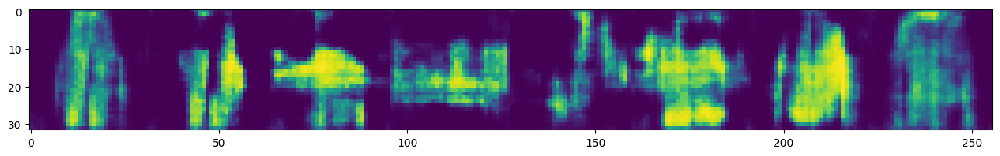

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 2/20] [D loss: 0.7327] [G loss: 1.6924]


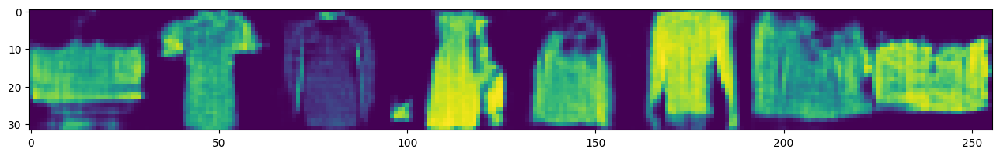

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 3/20] [D loss: 0.4946] [G loss: 2.3784]


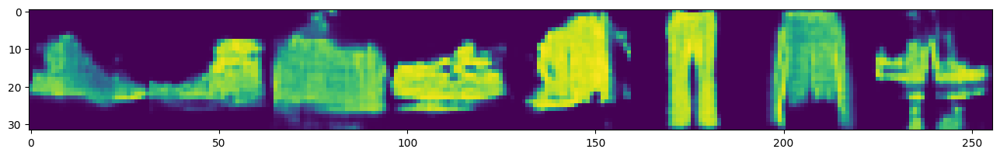

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 4/20] [D loss: 0.3826] [G loss: 2.9165]


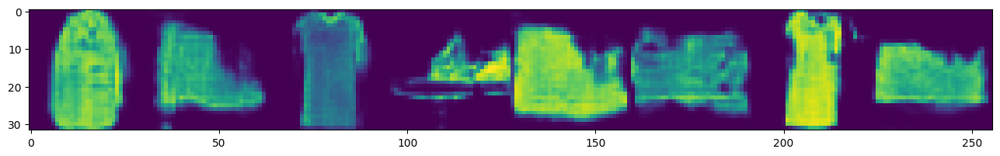

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 5/20] [D loss: 0.3255] [G loss: 3.3098]


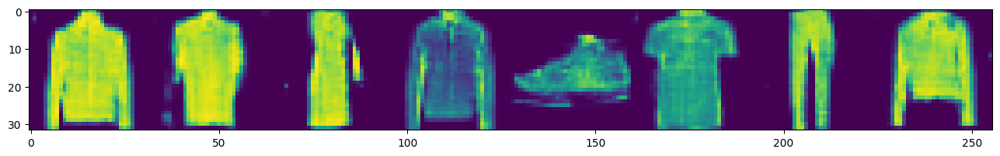

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 6/20] [D loss: 0.2882] [G loss: 3.6356]


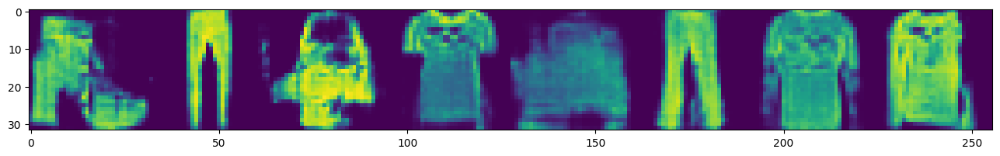

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 7/20] [D loss: 0.2699] [G loss: 3.8449]


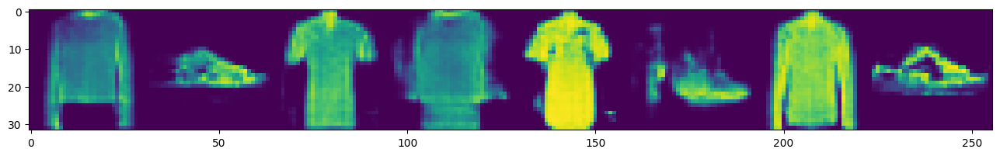

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 8/20] [D loss: 0.2489] [G loss: 4.0432]


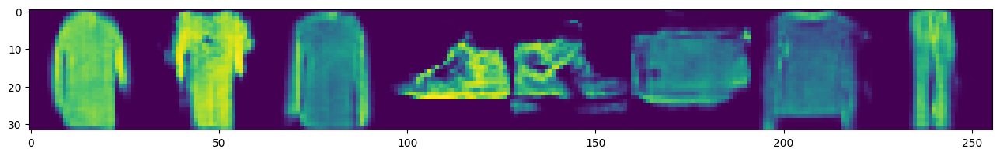

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 9/20] [D loss: 0.2354] [G loss: 4.2088]


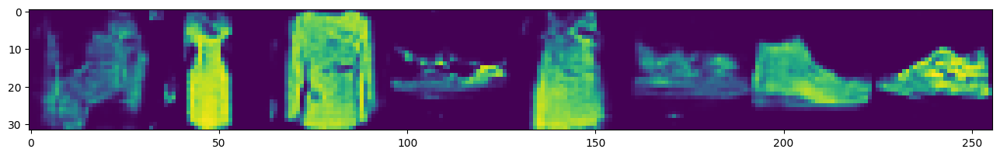

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 10/20] [D loss: 0.2253] [G loss: 4.3729]


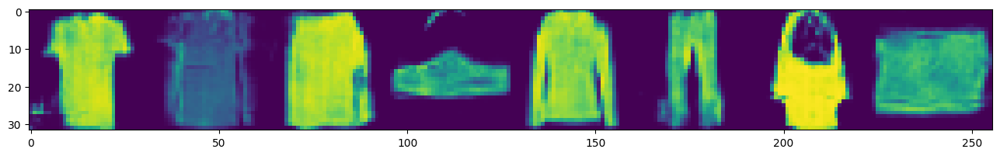

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 11/20] [D loss: 0.2139] [G loss: 4.5124]


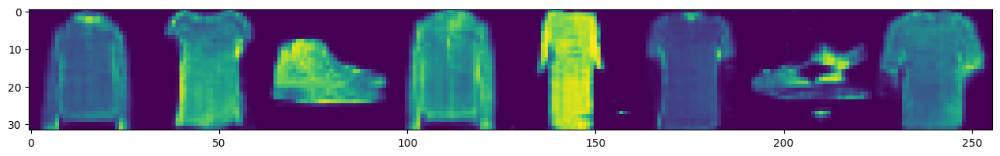

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 12/20] [D loss: 0.2097] [G loss: 4.6361]


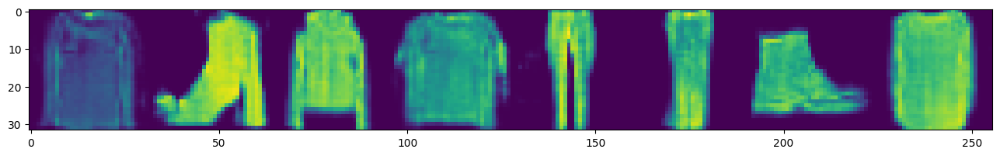

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 13/20] [D loss: 0.1950] [G loss: 4.8253]


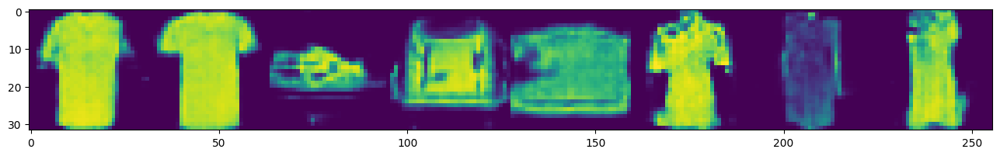

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 14/20] [D loss: 0.1845] [G loss: 4.9494]


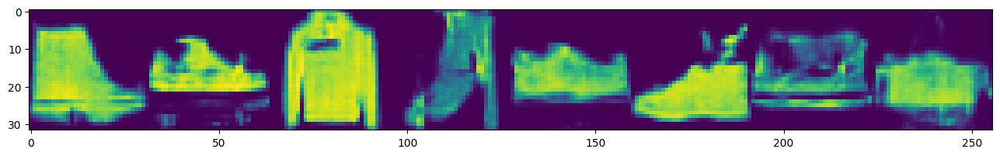

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 15/20] [D loss: 0.1819] [G loss: 5.0904]


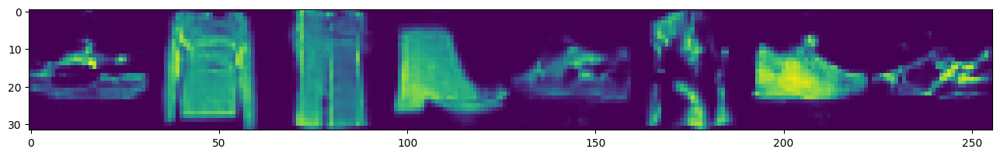

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 16/20] [D loss: 0.1755] [G loss: 5.1501]


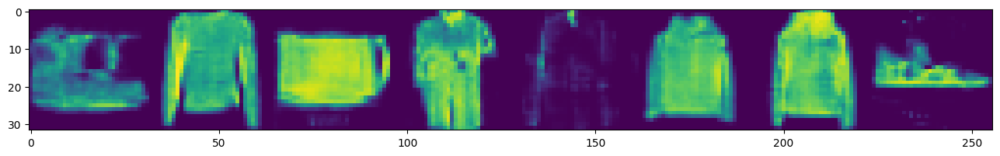

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 17/20] [D loss: 0.1761] [G loss: 5.2055]


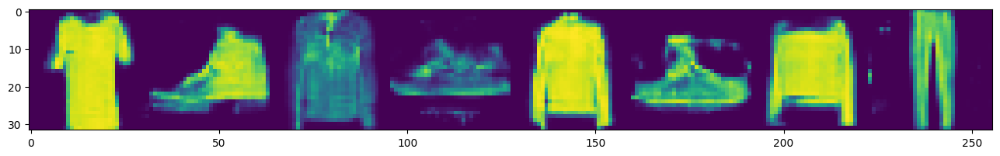

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 18/20] [D loss: 0.1662] [G loss: 5.3601]


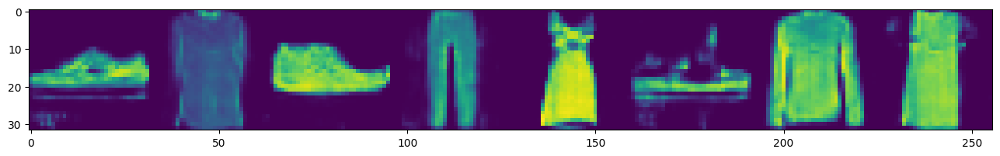

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 19/20] [D loss: 0.1672] [G loss: 5.4015]


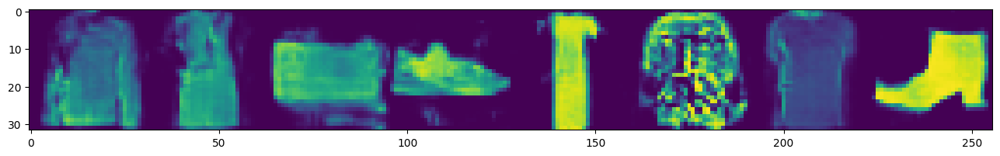

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 20/20] [D loss: 0.1537] [G loss: 5.5844]


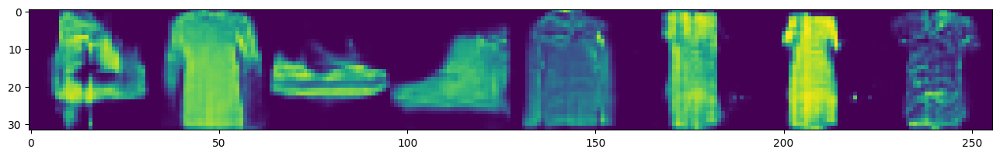

In [ ]:
gan = GANManager(
    img_size=32,
    latent_dim=64,
    hidden_dim=256,
    lr=0.0002,
)

gan_history = gan.train(dataloader, epochs=20, sample_interval=937)

### ❓ **Question 2**

- *(5 points)* **How can we generate images from a specific class in GAN?**  
- *(Bonus - 15 points)* **Implement your idea and plot 8 images from each of the 10 classes.**


In order to generate images belonging to a specific class in a Generative Adversarial Network (GAN), we can introduce a conditioning variable to both the generator and the discriminator. This conditioning variable is responsible for encoding (or embedding) the class label of the image we wish to generate. During the training process, this conditioning variable is typically concatenated with the random noise vector in the generator, and with the image tensor in the discriminator.

## Conditional GAN

  0%|          | 0/7500 [00:00<?, ?it/s]

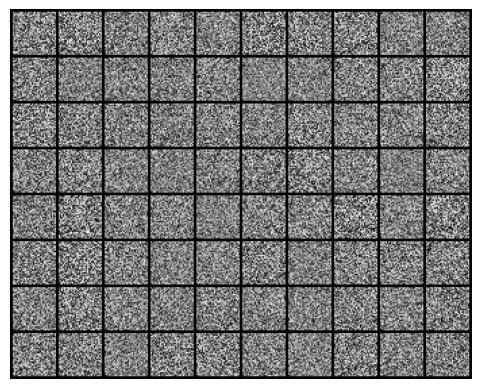

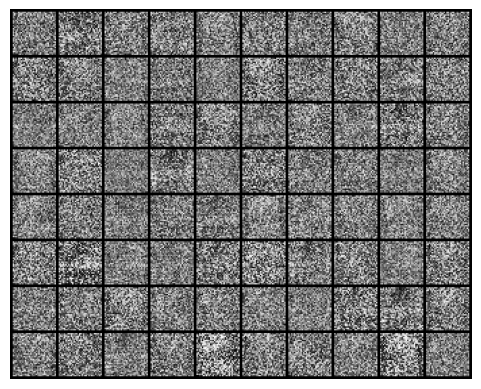

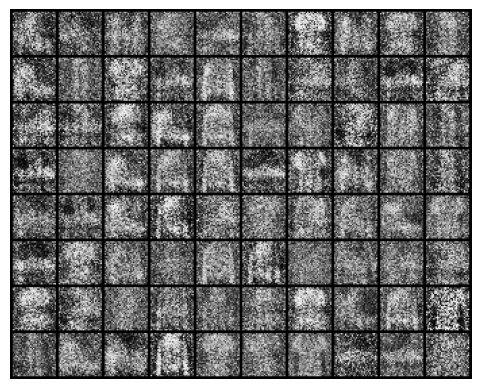

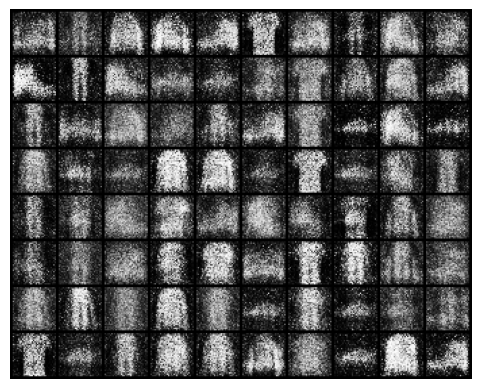

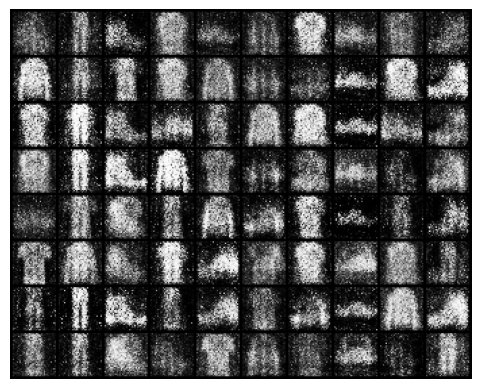

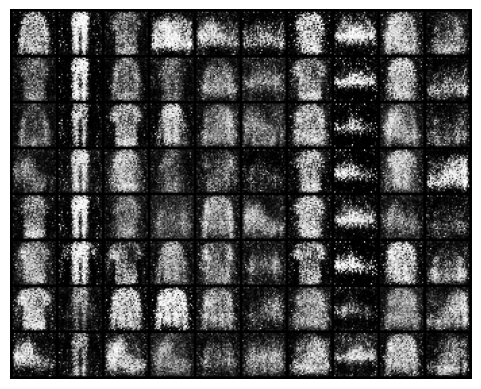

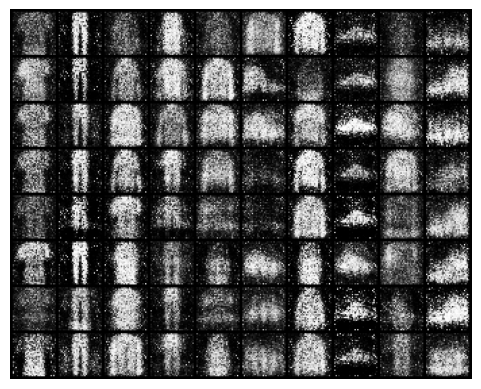

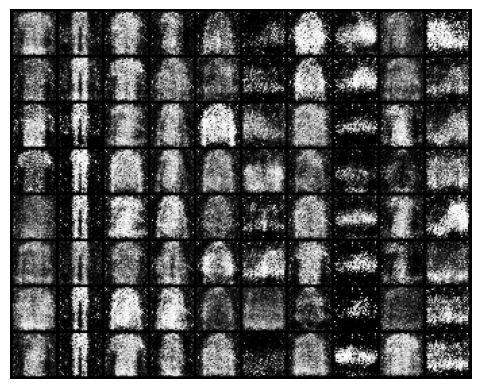

[Epoch: 1/10] [D loss: 1.1371] [G loss: 0.9492]


  0%|          | 0/7500 [00:00<?, ?it/s]

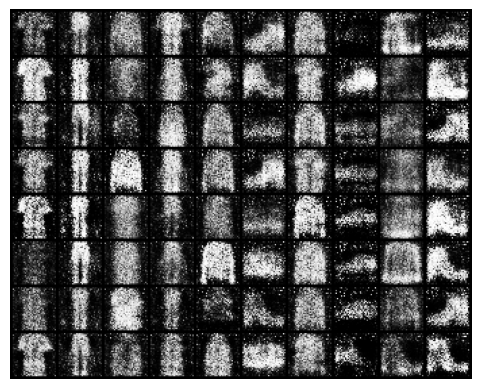

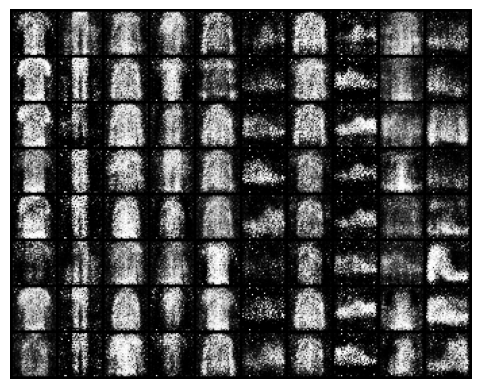

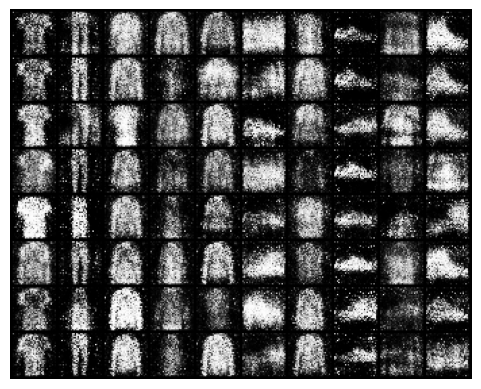

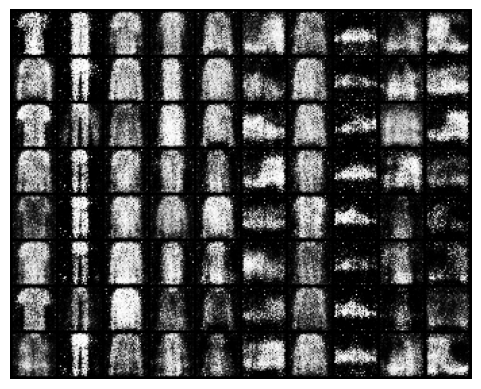

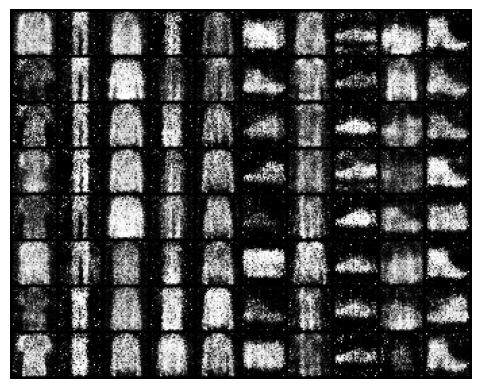

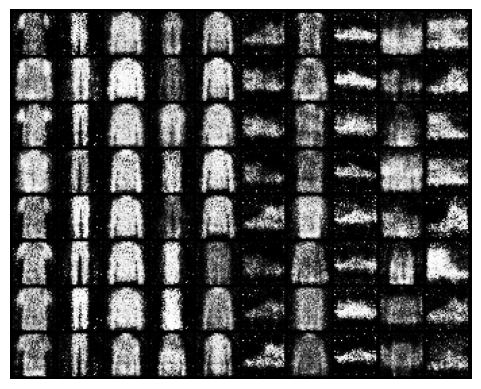

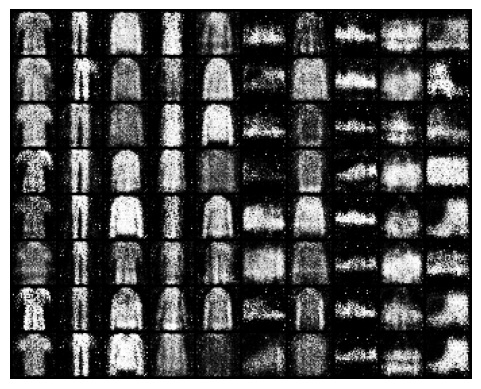

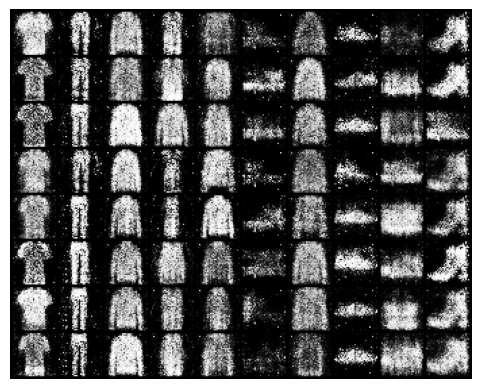

[Epoch: 2/10] [D loss: 0.8735] [G loss: 1.3637]


  0%|          | 0/7500 [00:00<?, ?it/s]

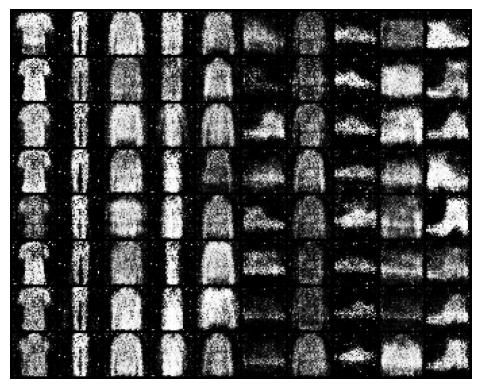

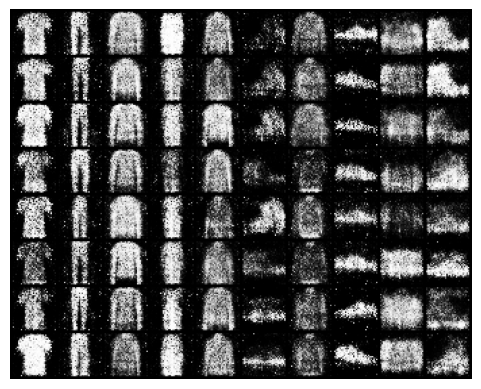

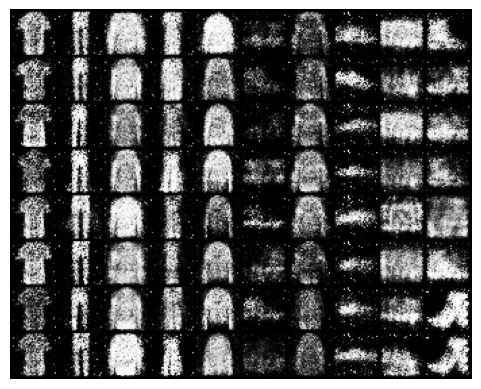

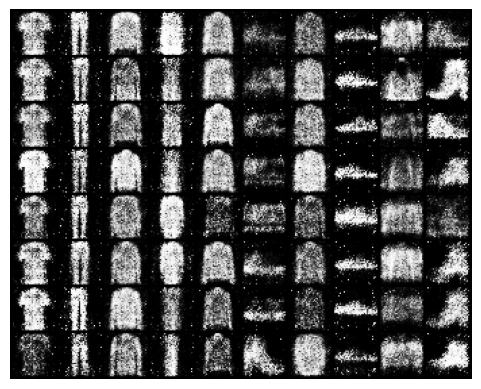

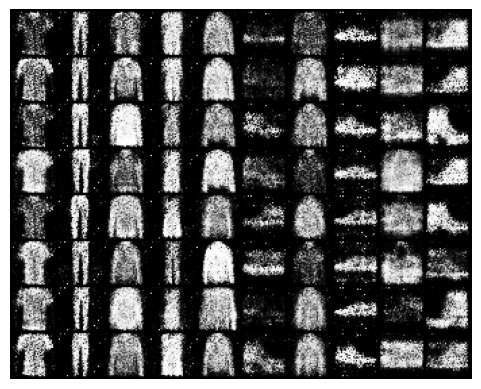

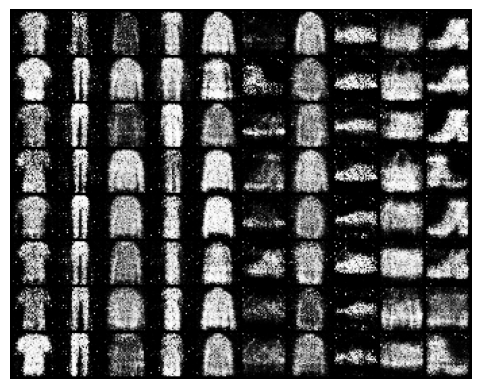

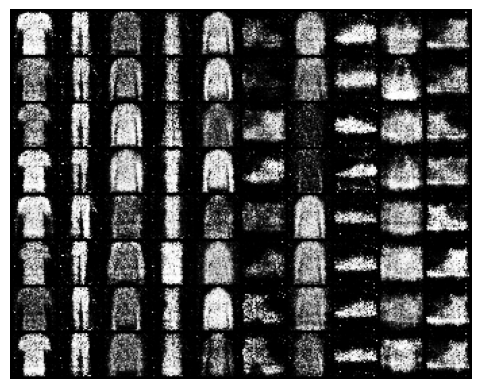

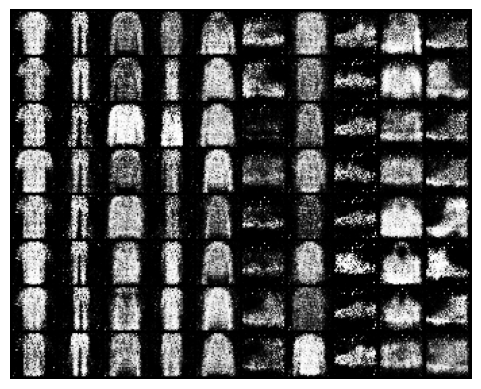

[Epoch: 3/10] [D loss: 0.8008] [G loss: 1.6251]


  0%|          | 0/7500 [00:00<?, ?it/s]

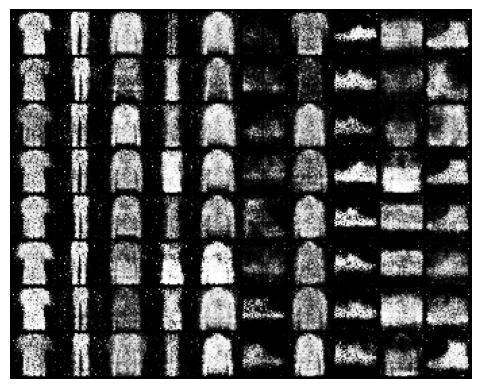

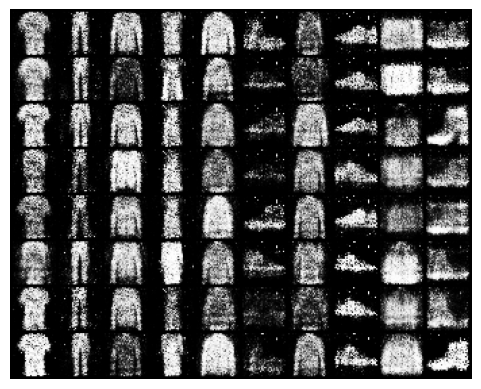

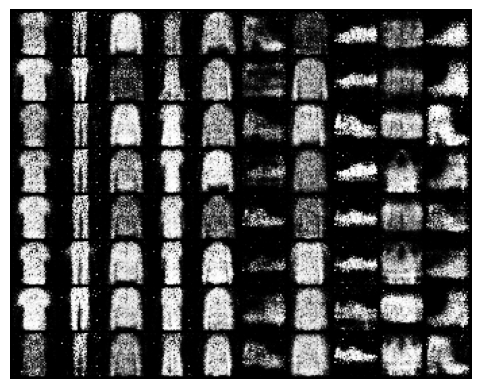

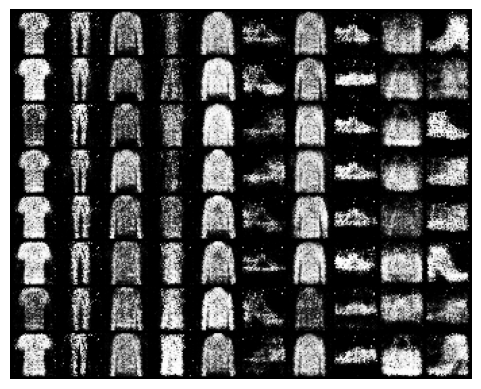

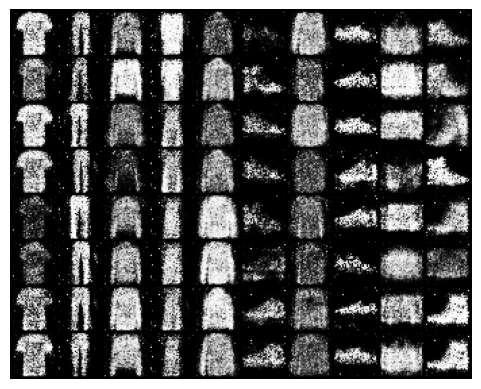

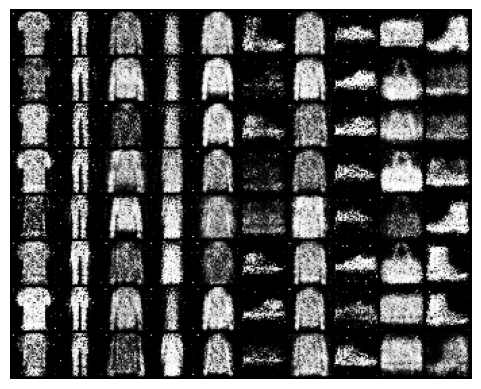

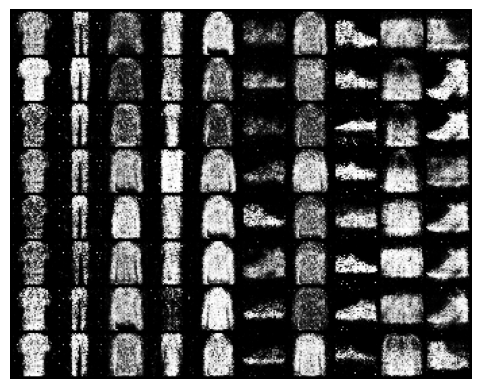

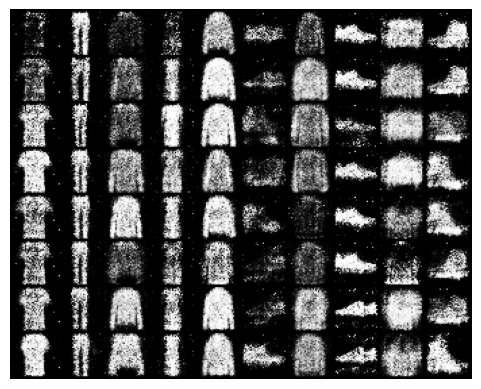

[Epoch: 4/10] [D loss: 0.7619] [G loss: 1.7995]


  0%|          | 0/7500 [00:00<?, ?it/s]

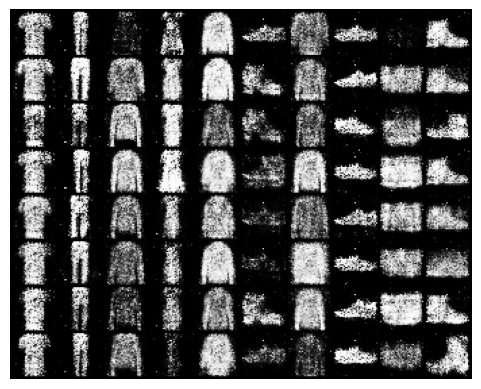

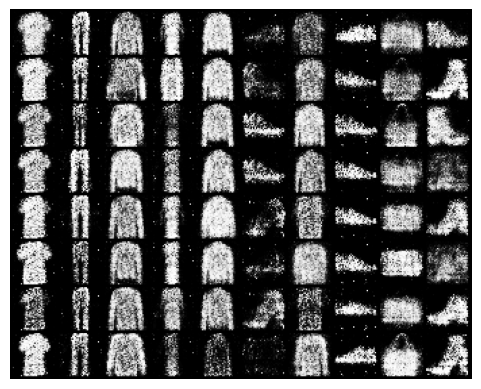

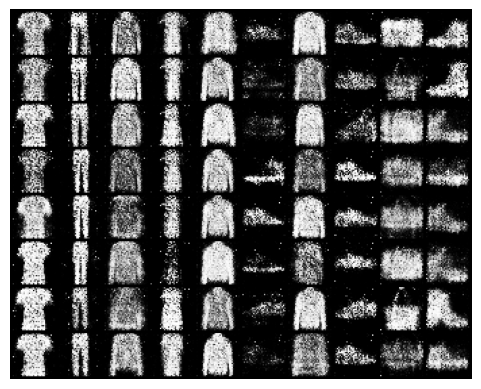

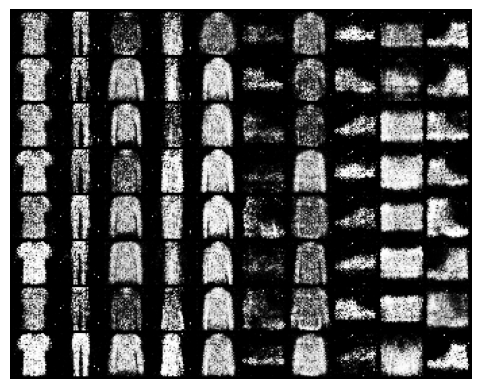

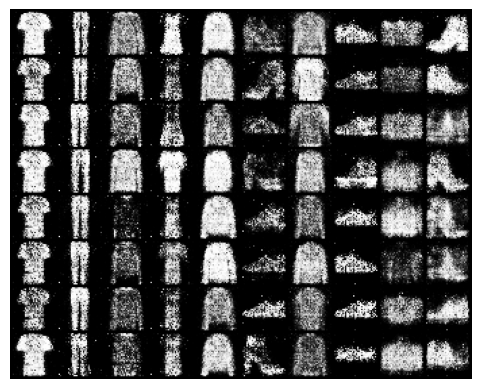

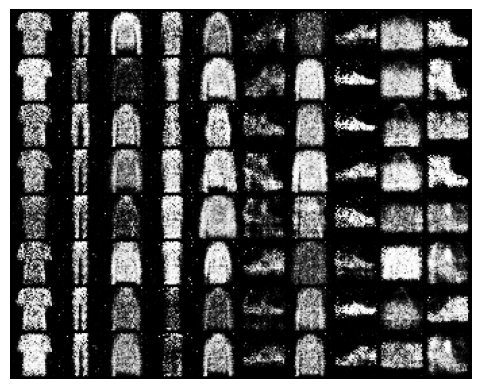

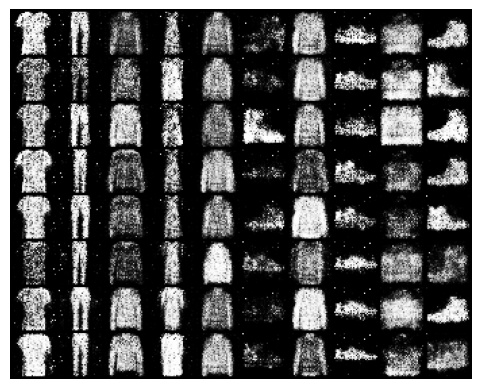

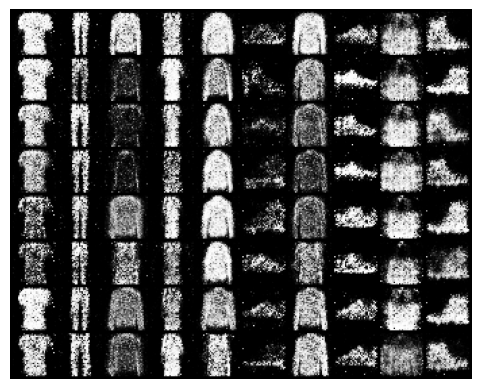

[Epoch: 5/10] [D loss: 0.7187] [G loss: 1.9673]


  0%|          | 0/7500 [00:00<?, ?it/s]

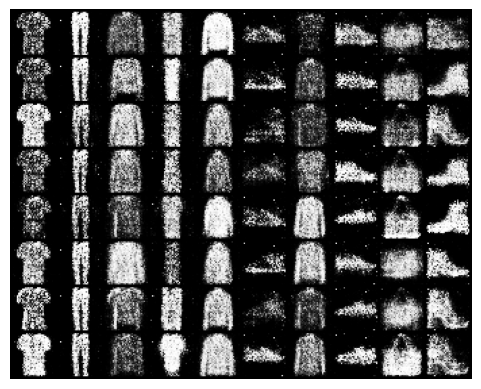

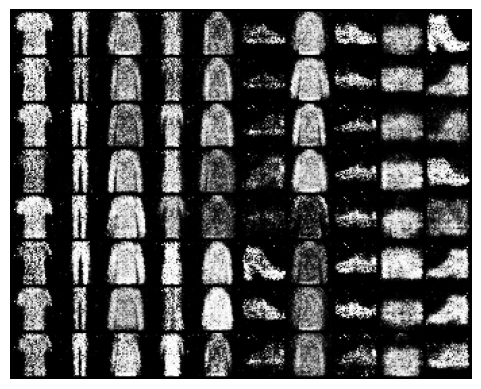

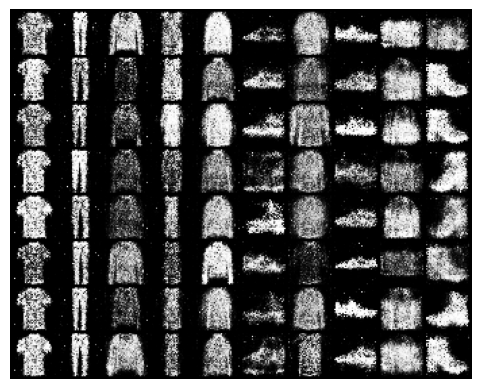

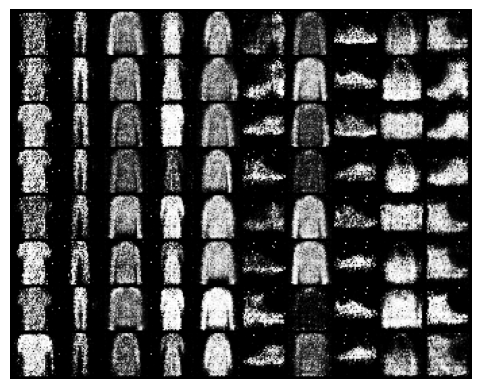

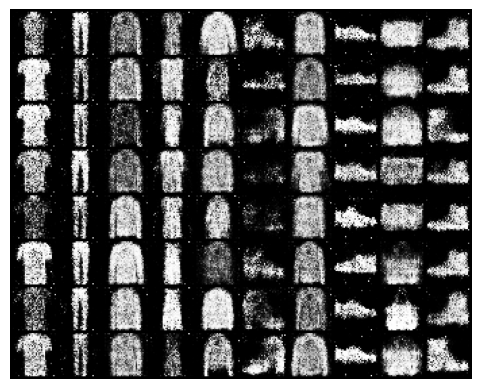

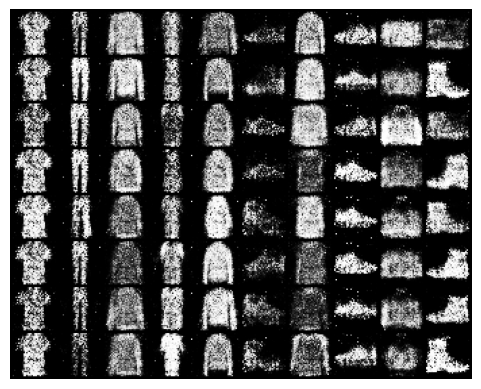

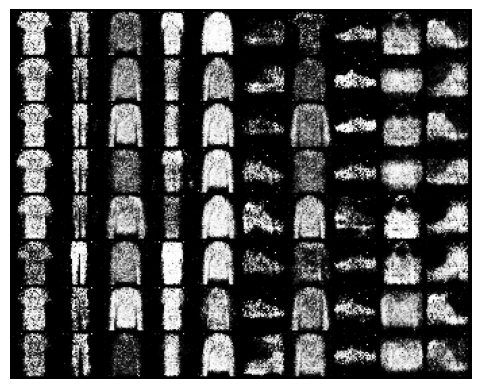

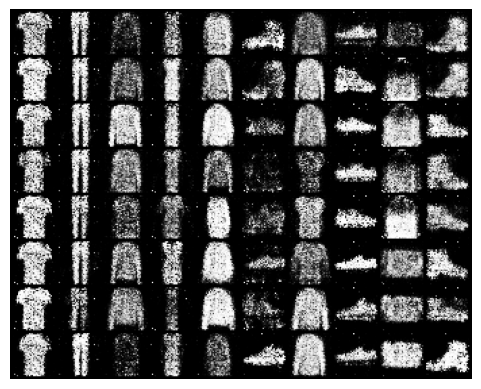

[Epoch: 6/10] [D loss: 0.7112] [G loss: 2.0589]


  0%|          | 0/7500 [00:00<?, ?it/s]

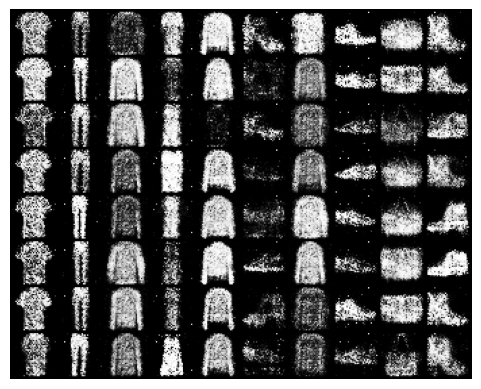

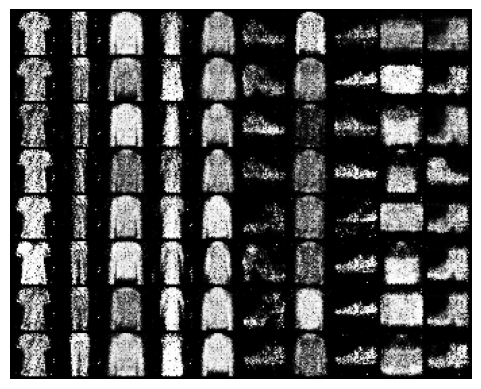

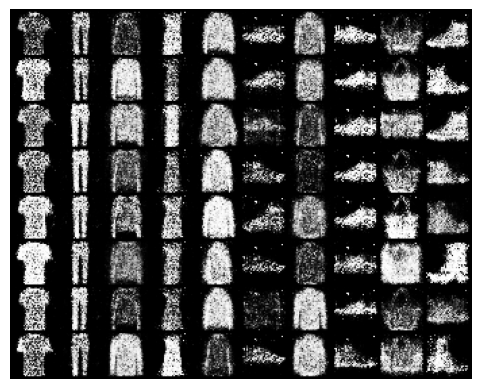

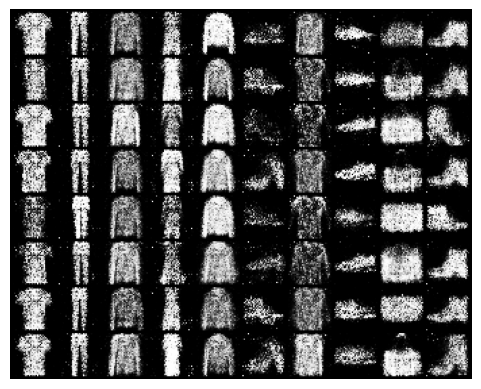

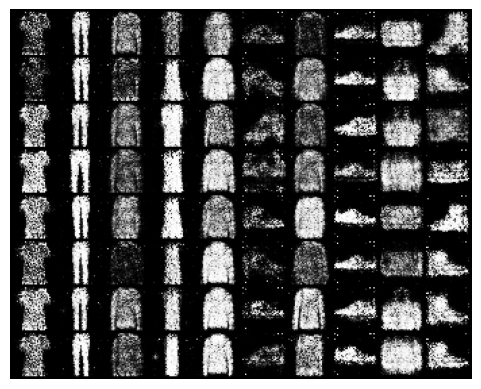

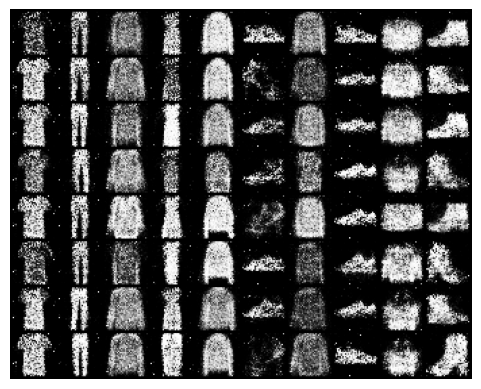

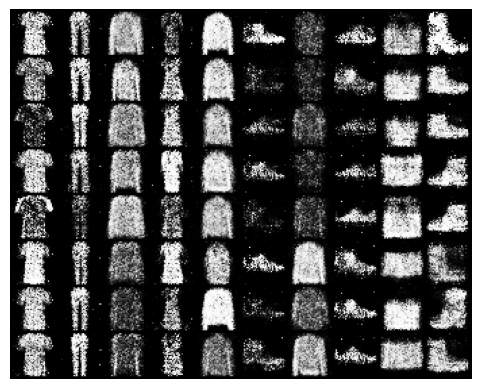

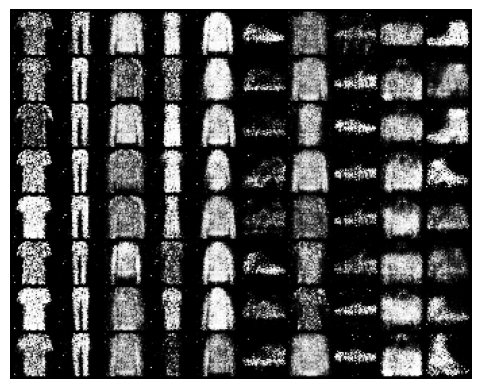

[Epoch: 7/10] [D loss: 0.7146] [G loss: 2.1226]


  0%|          | 0/7500 [00:00<?, ?it/s]

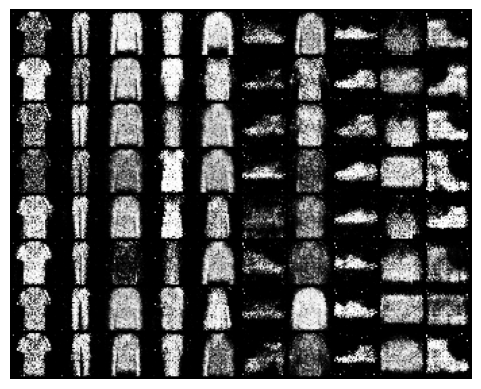

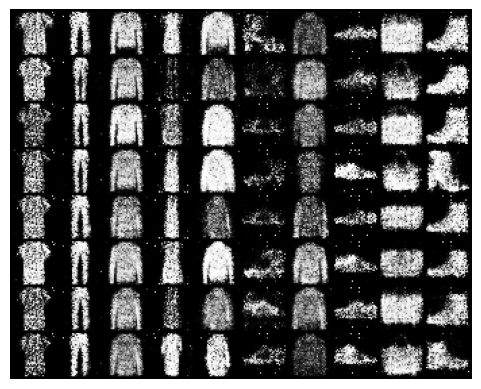

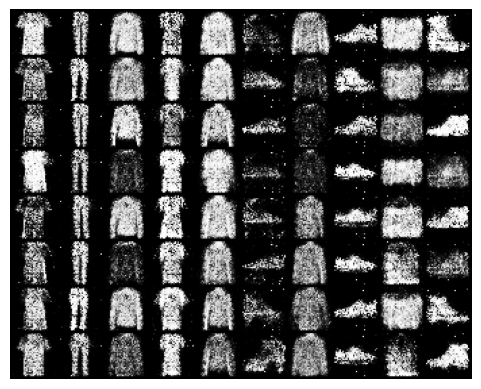

In [ ]:
from torchvision.utils import make_grid

class ConditionalGenerator(nn.Module):
    def __init__(self, latent_dim=64, img_size=32, hidden_dim=128, n_classes=10):
        super(ConditionalGenerator, self).__init__()
        self.img_size = img_size
        self.embed = nn.Embedding(n_classes, n_classes)

        self.layers = nn.Sequential(
            nn.Linear(latent_dim + n_classes, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim, hidden_dim * 2),
            nn.BatchNorm1d(hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim * 2, hidden_dim * 4),
            nn.BatchNorm1d(hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim * 4, img_size * img_size),
            nn.Tanh()
        )

    def forward(self, z, labels):
        labels = self.embed(labels)
        x = torch.cat([z, labels], 1)
        img = self.layers(x)
        img = img.view(-1, 1, self.img_size, self.img_size)
        return img

class ConditionalDiscriminator(nn.Module):
    def __init__(self, img_size=32, hidden_dim=128, n_classes=10):
        super(ConditionalDiscriminator, self).__init__()
        self.img_size = img_size
        self.hidden_dim = hidden_dim
        self.embed = nn.Embedding(n_classes, n_classes)

        self.layers = nn.Sequential(
            nn.Linear(img_size * img_size + n_classes, hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim * 4, hidden_dim * 2),
            nn.BatchNorm1d(hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(hidden_dim, 1),
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        img = img.view(-1, self.img_size * self.img_size)
        labels = self.embed(labels)
        x = torch.cat([img, labels], 1)
        real_or_fake = self.layers(x)
        return real_or_fake


class ConditionalGANManager():
    def __init__(self, img_size=32, latent_dim=64, hidden_dim=128, lr=0.0001, n_classes=10):
        self.latent_dim = latent_dim
        self.n_classes = n_classes
        self.generator = ConditionalGenerator(latent_dim=latent_dim, img_size=img_size, hidden_dim=hidden_dim, n_classes=n_classes).to(DEVICE)
        self.discriminator = ConditionalDiscriminator(img_size=img_size, hidden_dim=hidden_dim, n_classes=n_classes).to(DEVICE)

        self.optimizer_G = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(0.5, 0.999))
        self.optimizer_D = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
        self.loss = nn.BCELoss()

    def plot_class_samples(self, n_samples=8):
        z = torch.randn((n_samples * self.n_classes, self.latent_dim), device=DEVICE)
        gen_labels = torch.tensor([i for i in range(self.n_classes) for _ in range(n_samples)], device=DEVICE)
        gen_imgs = self.generator(z, gen_labels)

        rearranged_imgs = torch.zeros((n_samples, self.n_classes, 32, 32), device=DEVICE)
        for i in range(self.n_classes):
            for j in range(n_samples):
                rearranged_imgs[j, i] = gen_imgs[i * n_samples + j].squeeze()

        self.plot_images_cgan(rearranged_imgs)

    def plot_images_cgan(self, images):
        n_samples, n_classes, h, w = images.shape
        img_grid = make_grid(images.view(-1, 1, h, w), nrow=n_classes, normalize=True)
        np_img = img_grid.cpu().numpy().transpose((1, 2, 0))
        plt.imshow(np_img)
        plt.axis('off')
        plt.show()


    def train(self, dataloader, epochs=10, sample_interval=937):
        real_labels = torch.ones((dataloader.batch_size,1), device=DEVICE)
        fake_labels = torch.zeros((dataloader.batch_size, 1), device=DEVICE)
        history = dict(g_loss=[], d_loss=[])
        for epoch in range(epochs):
            total_g_loss = []
            total_d_loss = []

            for i, (imgs, labels) in enumerate(tqdm(dataloader)):
                imgs, labels = imgs.to(DEVICE), labels.to(DEVICE)

                # Train the discriminator
                self.optimizer_D.zero_grad()

                # Real images
                real_preds = self.discriminator(imgs, labels)
                real_loss = self.loss(real_preds, real_labels)
                real_loss.backward()

                # Fake images
                z = torch.randn((dataloader.batch_size, self.latent_dim), device=DEVICE)
                gen_labels = torch.randint(0, self.n_classes, (dataloader.batch_size,), device=DEVICE)
                fake_imgs = self.generator(z, gen_labels)
                fake_preds = self.discriminator(fake_imgs.detach(), gen_labels)
                fake_loss = self.loss(fake_preds, fake_labels)
                fake_loss.backward()

                d_loss = real_loss + fake_loss
                self.optimizer_D.step()

                # Train the generator
                self.optimizer_G.zero_grad()

                fake_preds = self.discriminator(fake_imgs, gen_labels)
                g_loss = self.loss(fake_preds, real_labels)
                g_loss.backward()
                self.optimizer_G.step()

                total_g_loss.append(g_loss.item())
                total_d_loss.append(d_loss.item())

                if (i+1) % sample_interval == 0:
                    self.plot_class_samples()

            history['g_loss'].append(sum(total_g_loss)/len(total_g_loss))
            history['d_loss'].append(sum(total_d_loss)/len(total_d_loss))
            mean_d_loss = np.mean(total_d_loss)
            mean_g_loss = np.mean(total_g_loss)

            print(
                "[Epoch: %d/%d] [D loss: %.4f] [G loss: %.4f]"
                % (epoch+1, epochs, mean_d_loss, mean_g_loss)
            )

        return history

cgan = ConditionalGANManager()
cgan_history = cgan.train(dataloader, epochs=10)

## DDPM (75 + 25 points)

Please review the Denoising Diffusion Probabilistic Models (DDPM) paper available at this link: [DDPM Paper](https://arxiv.org/pdf/2006.11239).

Denoising diffusion probabilistic models (DDPMs) generate images by iteratively denoising a completely random pattern in a step-by-step process. These models learn two key components: a set of diffusion steps that define how noise evolves over time, and a denoising function that progressively removes noise at each step.

The denoising function is typically implemented as a neural network. This network takes the noisy data and the corresponding time step as inputs and produces the denoised data as output. Through multiple denoising iterations across time steps, the model ultimately generates an image that resembles those in the training distribution.

The overall procedure for training and sampling in DDPMs is concisely outlined in the pseudocode provided in the DDPM paper.

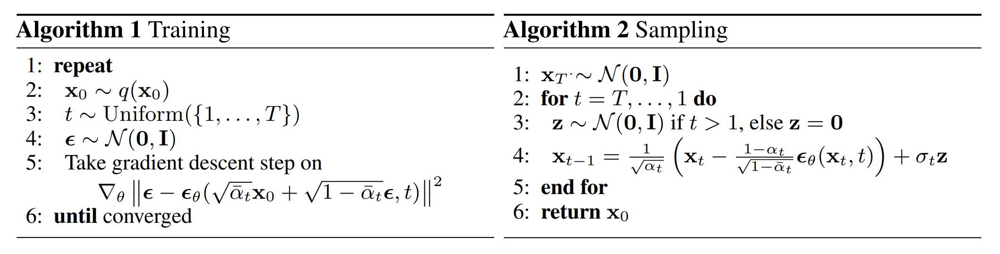

The pseudocode shows that the loss function is defined as an MSE on per time step noise and the predicted noise for the current time step. So we only need to train a model that learns to reverse the noise from an input image at a specific time step. In this notebook, we will use the architecture proposed by the paper, a UNet with image and time as the inputs and predicted noise as the output. They augment the regular UNet with several sub-modules and techniques such as ResNets, Attention modules, etc. We describe the expected architecture for this notebook:

+ *ResNet:* As a base sub-module, we define each ResNet block as two consecutive convolutional layers with a GELU activation in between and Group Normalization after each convolutional layer. You can use this module in Down/Up blocks. Also, by removing the residual connection, you can use this block as a convolutional network throughout the network.
+ *Attention:* This is also a sub-module consisting of a Layer Normalization, Multi-head Attention (use from `torch.nn`), a residual connection, a feed-forward network, and another residual connection.
+ *Conditional UNet:* Each Up/Down block in UNet accepts positionally-encoded time as an input. The time index is encoded and added to the output of the block. You can use the sinusoidal position embeddings proposed in [Attention is All You Need.](https://arxiv.org/pdf/1706.03762.pdf)

You can implement the following structure for UNet:

+ Convolutional block
+ Down block
+ Attention
+ Down block
+ Attention
+ Down block
+ Attention

+ Convolutional block (bottleneck)
+ Convolutional block (bottleneck)
+ Convolutional block (bottleneck)

+ Up block
+ Attention
+ Up block
+ Attention
+ Up block
+ Attention
+ Convolutional block

In [ ]:
##########################################################
# TODO (40 points):
# Complete each class based on the previous explanations.
##########################################################

class ConvResNet(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None, residual=False):
        super(ConvResNet, self).__init__()

        self.residual = residual
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.GroupNorm(1, mid_channels),
            nn.GELU(),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.GroupNorm(1, out_channels),
        )

        self.gelu = nn.GELU()

    def forward(self, x):
        if self.residual:
            return self.gelu(x + self.double_conv(x))
        else:
            return self.gelu(self.double_conv(x))

class Attention(nn.Module):
    def __init__(self,  h_size, num_s):
        super(Attention, self).__init__()

        self.num_s = num_s
        self.h_size = h_size
        self.multi_head_att = nn.MultiheadAttention(h_size, 4, batch_first=True)
        self.layer_norm = nn.LayerNorm([h_size])
        self.fc = nn.Sequential(
            nn.LayerNorm([h_size]),
            nn.Linear(h_size, h_size),
            nn.GELU(),
            nn.Linear(h_size, h_size),
        )

    def forward(self, x):
        x = x.view(-1, self.h_size, self.num_s * self.num_s).swapaxes(1, 2)
        x_normed = self.layer_norm(x)
        context, _ = self.multi_head_att(x_normed, x_normed, x_normed)
        context = context + x
        context = self.fc(context) + context
        context = context.swapaxes(2, 1).view(-1, self.h_size, self.num_s, self.num_s)
        return context

class Down(nn.Module):
    def __init__(self,  in_channels, out_channels):
        super(Down, self).__init__()

        self.conv = nn.Sequential(
            ConvResNet(in_channels, in_channels, residual=True),
            ConvResNet(in_channels, out_channels),
        )
        self.max_pool = nn.MaxPool2d(2)

    def forward(self, x, t):
        skip = self.conv(x)
        out = self.max_pool(skip)
        return out, skip


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()
        self.up_sample = nn.ConvTranspose2d(in_channels, in_channels//2, kernel_size=(2, 2), stride=2, padding=0)
        self.conv = ConvResNet(in_channels, in_channels, residual=True)
        self.conv2 = ConvResNet(in_channels, out_channels, in_channels // 2)

    def forward(self, x, skip, t):
        x1 = self.up_sample(x)
        x = torch.cat([skip, x1], dim=1)
        x = self.conv(x)
        x = self.conv2(x)
        return x

class OutputConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutputConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

def pos_encoding(t, channels, embed_size):
    inv_freq = 1.0 / (
        10000
        ** (torch.arange(0, channels, 2, device=DEVICE).float() / channels)
    )
    pos_enc_a = torch.sin(t.repeat(1, channels // 2) * inv_freq)
    pos_enc_b = torch.cos(t.repeat(1, channels // 2) * inv_freq)
    pos_enc = torch.cat([pos_enc_a, pos_enc_b], dim=-1)

    return pos_enc.view(-1, channels, 1, 1).repeat(1, 1, embed_size, embed_size)


class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        self.conv1 = ConvResNet(1, 16)
        self.down1 = Down(16, 32)
        self.down2 = Down(32, 64)
        self.down3 = Down(64, 128)

        self.bottleneck = nn.Sequential(
            ConvResNet(128, 128),
            ConvResNet(128, 256),
        )

        self.up1 = Up(256, 128)
        self.up2 = Up(128, 64)
        self.up3 = Up(64, 32)

        self.out_conv = OutputConv(32, 1)

        self.att1 = Attention(32, 16)
        self.att2 = Attention(64, 8)
        self.att3 = Attention(128, 4)

        self.att4 = Attention(128, 8)
        self.att5 = Attention(64, 16)
        self.att6 = Attention(32, 32)

    def forward(self, x, t):
        x1 = self.conv1(x)
        x2, x2_skip = self.down1(x1,t)
        x3 = self.att1(x2 + pos_encoding(t, 32, 16))
        x4, x4_skip = self.down2(x3,t)
        x5 = self.att2(x4 + pos_encoding(t, 64, 8))
        x6, x6_skip = self.down3(x5,t)
        x7 = self.att3(x6 + pos_encoding(t, 128, 4))

        x8 = self.bottleneck(x7)

        x9 = self.up1(x8, x6_skip,t)
        x10 = self.att4(x9 + pos_encoding(t, 128, 8))
        x11 = self.up2(x10, x4_skip,t)
        x12 = self.att5(x11 + pos_encoding(t, 64, 16))
        x13 = self.up3(x12, x2_skip, t)
        x14 = self.att6(x13  + pos_encoding(t, 32, 32))

        output = self.out_conv(x14)
        return output


In [ ]:
class DDPMManager():
    def __init__(self):

        self.T = 1000
        self.beta_start = 1e-4 # \beta_t is the sqrt(\sigma_t) from the pseudocode.
        self.beta_end = 0.02

        ##########################################################
        # TODO (6 points):
        # Instantiate the model and the optimizer. You can use Adam.
        # Define \alpha, \beta, and \bar{alpha} for all T time steps.
        # Use cosine scheduling for \beta.
        ##########################################################
        self.in_size = 32 * 32
        t = np.linspace(0, self.T, self.T)
        self.betas = torch.tensor(-1 * np.cos(math.pi * t / (2 * self.T)) * (self.beta_end - self.beta_start) + self.beta_end, dtype=torch.float32, device=DEVICE)
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(DEVICE)
        self.unet = UNet()
        self.unet.to(DEVICE)
        self.optimizer = torch.optim.Adam(self.unet.parameters(), lr=0.0002)
        self.lr_scheduler = ReduceLROnPlateau(self.optimizer, mode='min', factor=0.1, patience=5, verbose=True)


    def train(self, dataloader, epochs):

        history = dict(loss=[])
        for epoch in range(epochs):
            total_loss = []
            for i, (batch_x, _) in enumerate(tqdm(dataloader)):
                batch_x = batch_x.to(DEVICE)

                ##########################################################
                # TODO (15 points):
                # Sample a time step `t` and create noisy images for the
                # `t`th step of the diffusion according to \bar{alpha}
                # values. Then predict the noise using self.unet.
                # Compute the loss and backpropagate.
                ##########################################################
                ts = torch.randint(0, self.T, [batch_x.shape[0]], device=DEVICE)
                noise_imgs = []
                epsilons = torch.randn(batch_x.shape, device=DEVICE)
                for i in range(len(ts)):
                    alpha_bar = self.alpha_bars[ts[i]]
                    noise_imgs.append(
                        (math.sqrt(alpha_bar) * batch_x[i]) + (math.sqrt(1 - alpha_bar) * epsilons[i])
                    )

                noise_imgs = torch.stack(noise_imgs, dim=0)

                e_hat = self.unet(noise_imgs, ts.unsqueeze(-1).type(torch.float))

                loss = nn.functional.mse_loss(
                    e_hat.reshape(-1, self.in_size), epsilons.reshape(-1, self.in_size)
                )
                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()
                total_loss.append(loss.item())

            mean_loss = np.mean(total_loss)
            self.lr_scheduler.step(mean_loss)
            print(
                "[Epoch: %d/%d] [loss: %.4f]"
                % (epoch+1, epochs, mean_loss)
            )
            if epoch % 2:
                self.sample(8, plot=True)

            history['loss'].append(mean_loss)

        return history


    def sample(self, n, plot=True):

        ##########################################################
        # TODO (8 points):
        # Generate a random pattern `x`.
        # Then denoise `x` for self.T time steps.
        # Choose `n` images from the generated images during self.T
        # time steps (`xs`).
        # The purpose is to show how denoising converts the pure
        # noise to an image after self.T time steps.
        ##########################################################

        with torch.no_grad():
            x = torch.randn(1, 1, 32, 32, device=DEVICE)
            xs = []
            for t in reversed(range(self.T)):
                alpha_bar_t = self.alpha_bars[t]
                epsilons = torch.randn(1, 1, 32, 32, device=DEVICE) if t != 0 else torch.zeros(1, 1, 32, 32, device=DEVICE)

                e_hat_t = self.unet(x, t * torch.ones(1, device=DEVICE))

                x = 1/math.sqrt(self.alphas[t]) * (x - (1 - self.alphas[t]) * e_hat_t / math.sqrt(1- self.alpha_bars[t]))
                x += math.sqrt(self.betas[t]) * epsilons
                if (t+1) % 150 == 0 or t == 0 or t == (self.T - 1):
                    xs.append(x.clone().cpu().reshape(1, 1, 32, 32))
            xs = torch.cat(xs, dim=0)  # Concatenate tensors along the batch dimension
            xs = xs.reshape(n, 1, 32, 32)  # Reshape xs to have the desired shape
            if plot:
                plot_images(xs)
            return x

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 1/10] [loss: 0.0798]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 2/10] [loss: 0.0557]


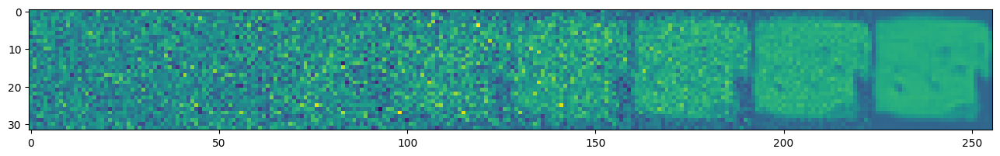

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 3/10] [loss: 0.0512]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 4/10] [loss: 0.0498]


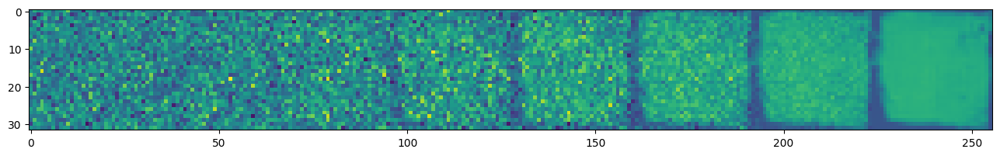

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 5/10] [loss: 0.0483]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 6/10] [loss: 0.0474]


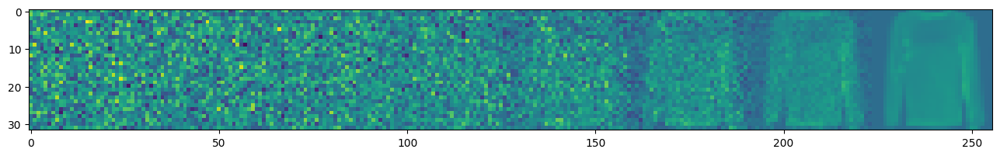

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 7/10] [loss: 0.0474]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 8/10] [loss: 0.0466]


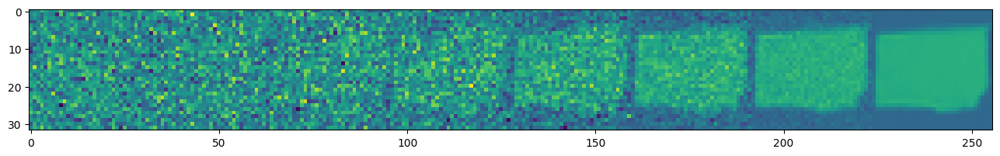

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 9/10] [loss: 0.0459]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 10/10] [loss: 0.0455]


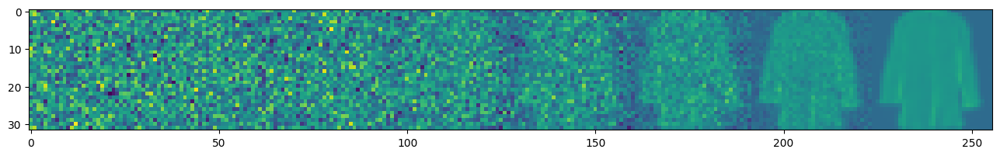

In [ ]:
ddpm = DDPMManager() # You can pass your arguments to the call.
ddpm_history = ddpm.train(dataloader, epochs=10)

### ❓ **Question 3**
- *(6 points)* How can we generate images from a specific target class in DDPM?
- *(Bonus - 25 points)* Implement your idea and plot one trajectory of denoised images per class.

First, for each class label, you should generate a class embedding—a vector that represents the class label within a continuous latent space. These embeddings can be constructed using methods like one-hot encoding, or more advanced techniques such as learned embeddings that capture deeper relationships within the data.

Next, train a Denoising Diffusion Probabilistic Model (DDPM) on the labeled dataset, integrating the class embeddings as an additional input to the model. During training, you will utilize the labeled images and their respective class embeddings, which will allow the model to learn the conditional distribution specific to each class.

To generate an image belonging to a specific class, follow these steps:

1. Sample a noise vector
z
2.  from a standard normal distribution.
Select the desired target class
c
.
3. Obtain the corresponding class embedding
e
 for class
c
.
4. Input the noise vector
z
 and the class embedding
e
 into the trained DDPM to generate an image
x
.

This process essentially guides the DDPM to generate images conditioned on the target class by leveraging both the noise vector and the class embedding during the generation phase.

## Conditional Diffusion Model

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 1/10] [loss: 0.0924]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 2/10] [loss: 0.0547]


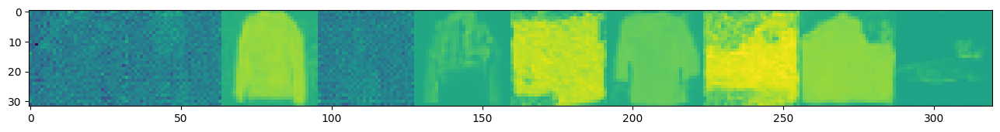

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 3/10] [loss: 0.0491]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 4/10] [loss: 0.0475]


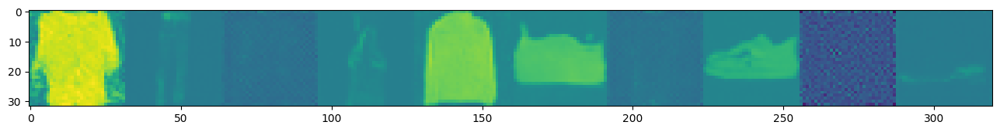

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 5/10] [loss: 0.0460]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 6/10] [loss: 0.0449]


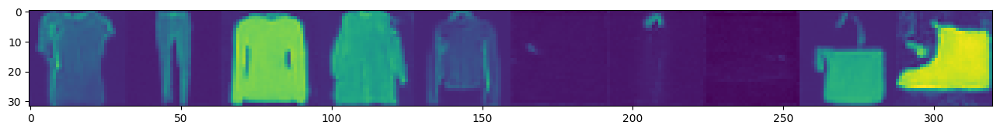

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 7/10] [loss: 0.0443]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 8/10] [loss: 0.0431]


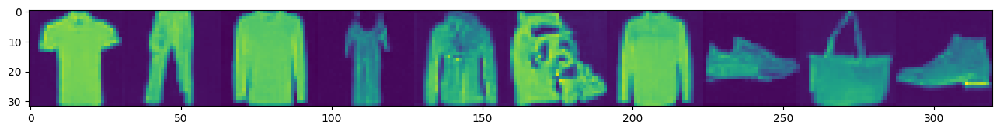

  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 9/10] [loss: 0.0431]


  0%|          | 0/7500 [00:00<?, ?it/s]

[Epoch: 10/10] [loss: 0.0428]


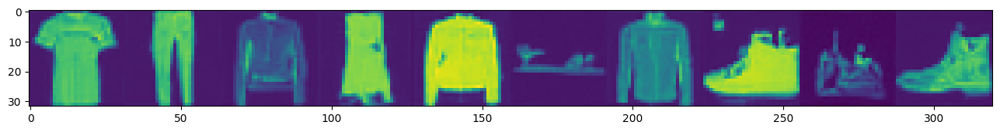

In [ ]:
class ConvResNet(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None, residual=False):
        super().__init__()
        self.residual = residual
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.GroupNorm(1, mid_channels),
            nn.GELU(),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.GroupNorm(1, out_channels),
        )

        self.gelu = nn.GELU()

    def forward(self, x):
        if self.residual:
            return self.gelu(x + self.double_conv(x))
        else:
            return self.gelu(self.double_conv(x))

class Attention(nn.Module):
    def __init__(self, h_size, num_s):
        super().__init__()
        self.num_s = num_s
        self.h_size = h_size
        self.multi_head_att = nn.MultiheadAttention(h_size, 4, batch_first=True)
        self.layer_norm = nn.LayerNorm([h_size])
        self.fc = nn.Sequential(
            nn.LayerNorm([h_size]),
            nn.Linear(h_size, h_size),
            nn.GELU(),
            nn.Linear(h_size, h_size),
        )

    def forward(self, x):
        x = x.view(-1, self.h_size, self.num_s * self.num_s).swapaxes(1, 2)
        x_normed = self.layer_norm(x)
        context, _ = self.multi_head_att(x_normed, x_normed, x_normed)
        context = context + x
        context = self.fc(context) + context
        context = context.swapaxes(2, 1).view(-1, self.h_size, self.num_s, self.num_s)
        return context

class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Sequential(
            ConvResNet(in_channels, in_channels, residual=True),
            ConvResNet(in_channels, out_channels),
        )
        self.max_pool = nn.MaxPool2d(2)

    def forward(self, x):
        skip = self.conv(x)
        out = self.max_pool(skip)
        return out, skip


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()
        self.up_sample = nn.ConvTranspose2d(in_channels, in_channels//2, kernel_size=(2, 2), stride=2, padding=0)
        self.conv = ConvResNet(in_channels, in_channels, residual=True)
        self.conv2 = ConvResNet(in_channels, out_channels, in_channels // 2)

    def forward(self, x1, x2):
        x1 = self.up_sample(x1)
        x = torch.cat([x2, x1], dim=1)
        x = self.conv(x)
        x = self.conv2(x)
        return x


class OutputConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutputConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

def pos_encoding(t, channels, embed_size):
    inv_freq = 1.0 / (
        10000
        ** (torch.arange(0, channels, 2, device=DEVICE).float() / channels)
    )
    pos_enc_a = torch.sin(t.repeat(1, channels // 2) * inv_freq)
    pos_enc_b = torch.cos(t.repeat(1, channels // 2) * inv_freq)
    pos_enc = torch.cat([pos_enc_a, pos_enc_b], dim=-1)

    return pos_enc.view(-1, channels, 1, 1).repeat(1, 1, embed_size, embed_size)

class ConditionalUNet(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.num_classes = num_classes
        self.embedding = nn.Embedding(num_classes, 64)
        self.conv1 = ConvResNet(1 + 64, 16)
        self.down1 = Down(16, 32)
        self.down2 = Down(32, 64)
        self.down3 = Down(64, 128)

        self.bottleneck = nn.Sequential(
            ConvResNet(128 + 64, 128),
            ConvResNet(128, 256),
        )

        self.up1 = Up(256, 128)
        self.up2 = Up(128, 64)
        self.up3 = Up(64, 32)

        self.out_conv = OutputConv(32, 1)

        self.att1 = Attention(32, 16)
        self.att2 = Attention(64, 8)
        self.att3 = Attention(128, 4)

        self.att4 = Attention(128, 8)
        self.att5 = Attention(64, 16)
        self.att6 = Attention(32, 32)

    def forward(self, x, t, labels):
        class_embed = self.embedding(labels)
        batch_size = x.shape[0]
        x = torch.cat([x, class_embed.view(batch_size, 64, 1, 1).repeat(1, 1, 32, 32)], dim=1)
        x1 = self.conv1(x)
        x2, x2_skip = self.down1(x1)
        x3 = self.att1(x2 + pos_encoding(t, 32, 16))
        x4, x4_skip = self.down2(x3)
        x5 = self.att2(x4 + pos_encoding(t, 64, 8))
        x6, x6_skip = self.down3(x5)
        x7 = self.att3(x6 + pos_encoding(t, 128, 4))

        x8 = self.bottleneck(torch.cat([x7, class_embed.view(batch_size, 64, 1, 1).repeat(1, 1, 4, 4)], dim=1))
        x9 = self.up1(x8, x6_skip)


        x10 = self.att4(x9 + pos_encoding(t, 128, 8))
        x11 = self.up2(x10, x4_skip)
        x12 = self.att5(x11 + pos_encoding(t, 64, 16))
        x13 = self.up3(x12, x2_skip)
        x14 = self.att6(x13  + pos_encoding(t, 32, 32))

        output = self.out_conv(x14)
        return output

class ConditionalDDPMManager():
    def __init__(self):
        self.in_size = 32 * 32
        self.T = 1000
        self.beta_small = 1e-4
        self.beta_large = 0.025

        t = np.linspace(0, self.T, self.T)
        self.betas = torch.tensor(-1 * np.cos(math.pi * t / (2 * self.T)) * (self.beta_large - self.beta_small) + self.beta_large, dtype=torch.float32, device=DEVICE)
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(DEVICE)


        self.unet = ConditionalUNet(10)
        self.unet.to(DEVICE)
        self.optimizer = torch.optim.Adam(self.unet.parameters(), lr=0.0002)
        self.lr_scheduler = ReduceLROnPlateau(self.optimizer, mode='min', factor=0.1, patience=5, verbose=True)

    def train(self, dataloader, epochs):
        history = dict(loss=[])
        for epoch in range(epochs):
            total_loss = []
            for i, (batch_x, labels) in enumerate(tqdm(dataloader)):
                batch_x = batch_x.to(DEVICE)
                labels = labels.to(DEVICE)
                ts = torch.randint(0, self.T, [batch_x.shape[0]], device=DEVICE)
                noise_imgs = []
                epsilons = torch.randn(batch_x.shape, device=DEVICE)
                for i in range(len(ts)):
                    alpha_bar = self.alpha_bars[ts[i]]
                    noise_imgs.append(
                        (math.sqrt(alpha_bar) * batch_x[i]) + (math.sqrt(1 - alpha_bar) * epsilons[i])
                    )

                noise_imgs = torch.stack(noise_imgs, dim=0)

                e_hat = self.unet(noise_imgs, ts.unsqueeze(-1).type(torch.float), labels)

                loss = nn.functional.mse_loss(
                    e_hat.reshape(-1, self.in_size), epsilons.reshape(-1, self.in_size)
                )
                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()
                total_loss.append(loss.item())

            mean_loss = np.mean(total_loss)
            self.lr_scheduler.step(mean_loss)
            print(
                "[Epoch: %d/%d] [loss: %.4f]"
                % (epoch+1, epochs, mean_loss)
            )

            history['loss'].append(mean_loss)

            if (epoch + 1) % 2 == 0:
                self.sample(plot=True)
        return history

    def sample(self, plot=True):
        with torch.no_grad():
            xs = []
            for label in range(10):
                x = torch.randn(1, 1, 32, 32, device=DEVICE)
                for t in reversed(range(self.T)):
                    alpha_bar_t = self.alpha_bars[t]
                    epsilons = torch.randn(1, 1, 32, 32, device=DEVICE) if t != 0 else torch.zeros(1, 1, 32, 32, device=DEVICE)

                    e_hat_t = self.unet(x, t * torch.ones(1, device=DEVICE), (label * torch.ones(1, device=DEVICE)).to(torch.int))

                    x = 1/math.sqrt(self.alphas[t]) * (x - (1 - self.alphas[t]) * e_hat_t / math.sqrt(1- self.alpha_bars[t]))
                    x += math.sqrt(self.betas[t]) * epsilons
                    if t == 0:
                        xs.append(x.clone().cpu().reshape(1, 1, 32, 32))
            xs = torch.cat(xs, dim=0)
            xs = xs.reshape(10, 1, 32, 32)
            if plot:
                plot_images(xs)
            return xs

cddpm = ConditionalDDPMManager()
cddpm_history = cddpm.train(dataloader, epochs=10)

## Comparisons (10 Points)

### Training History

- The training history for each model is stored in `[MODEL]_history`.
- Use these histories to **plot the loss curves** for all models.

### Visual Comparison

- **Sample Images**: Generate and display sample images from each model.
- **Comparison**: Analyze and compare the results visually to evaluate the performance of each model.

> **Tip:** Highlight key differences in the loss trends and image quality for a more insightful analysis.


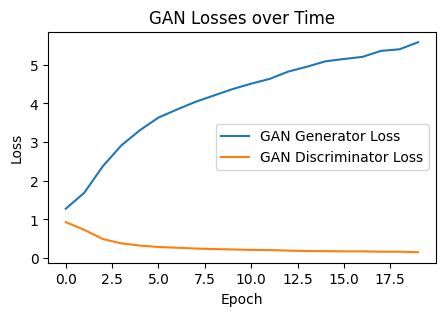

In [ ]:
def plot_losses(gan_history):
    figsize = (5, 3)
    plt.figure(figsize=figsize)
    plt.plot(gan_history['g_loss'], label='GAN Generator Loss')
    plt.plot(gan_history['d_loss'], label='GAN Discriminator Loss')
    plt.title('GAN Losses over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_losses(gan_history)

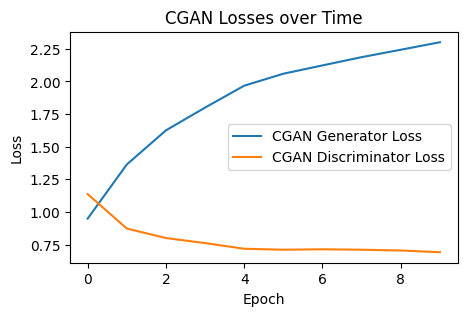

In [ ]:
def plot_losses(cgan_history):
    figsize = (5, 3)
    plt.figure(figsize=figsize)
    plt.plot(cgan_history['g_loss'], label='CGAN Generator Loss')
    plt.plot(cgan_history['d_loss'], label='CGAN Discriminator Loss')
    plt.title('CGAN Losses over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_losses(cgan_history)

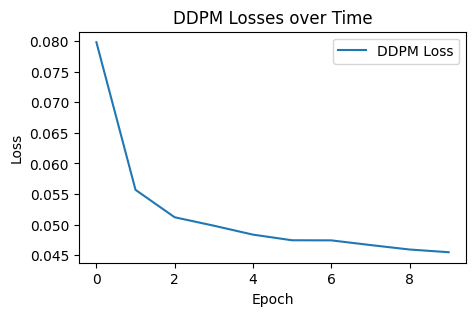

In [ ]:
def plot_losses(ddpm_history):
    figsize = (5, 3)
    plt.figure(figsize=figsize)
    plt.plot(ddpm_history['loss'], label='DDPM Loss')
    plt.title('DDPM Losses over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_losses(ddpm_history)

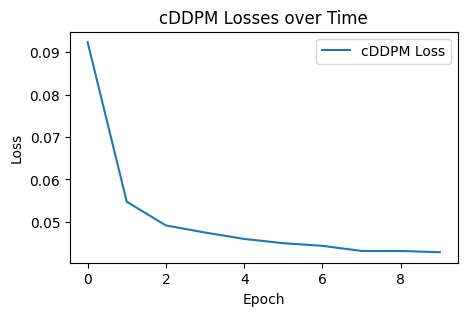

In [ ]:
def plot_losses(cddpm_history):
    figsize = (5, 3)
    plt.figure(figsize=figsize)
    plt.plot(cddpm_history['loss'], label='cDDPM Loss')
    plt.title('cDDPM Losses over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_losses(cddpm_history)

## Visual Comparison

Fashion MNIST:

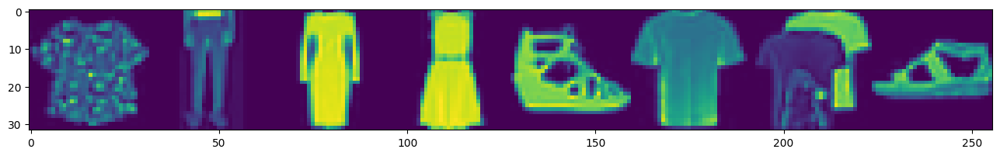


GAN :

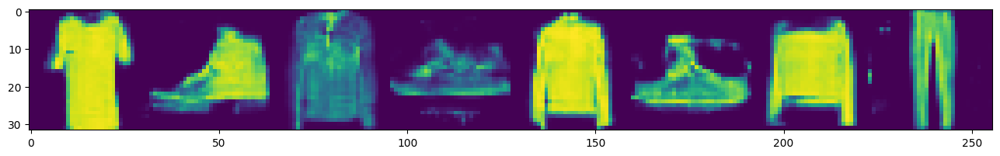

Conditional GAN:

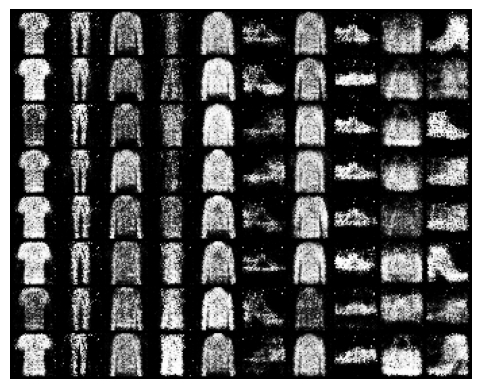

Diffusion Model:

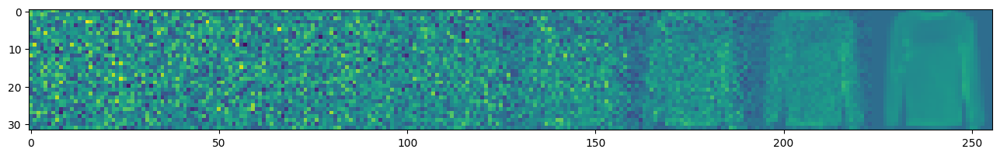

Conditional Diffusion Model:

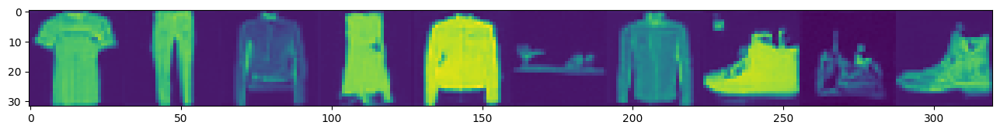
